# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDiscreteRepresentation
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 6

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_FishCargTank_14400_86400_600"
summary_models = SummaryModels(file_name)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=True, plot_figures=True, fig_size=fig_size, zoom=zoom)
visualise_trajectories_discrete = VisualiseTrajectories(region, save_figures=True, plot_figures=True, fig_size=fig_size,
                                                        zoom=zoom, continuous_representation=False)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_infos = utils.construct_read_data_info_file(file_name, processed_data_dir)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx, data_info, data_set_all):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories_discrete.fig_size
    visualise_trajectories_discrete.fig_size = (20,10)
    fig, ax = visualise_trajectories_discrete.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories_discrete.plot_figures
    visualise_trajectories_discrete.plot_figures = False
    
    # For plotting a single complete vessel trajectory on the static map - Discrete representation
    index = df_n.iloc[idx]["Index"]
    data_set = AISDiscreteRepresentation(file_name, data_info=data_info, indicies=[index])
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=False)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    reconstruction = train_evaluate.track_reconstructions(data_set_all, index)
    df_recon = reconstruction["Reconstruction"][1:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    
    # Do the actual plotting
    visualise_trajectories_discrete.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories_discrete.plot_figures = plot_figures_tmp
    visualise_trajectories_discrete.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories_discrete.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Best Cargo Reconstructions

In [5]:
# Focus on the n best cargo reconstructions first
vessel_type = "Cargo"
data = summary_models.run_evaluation_get_n(n=n, worst=False, vessel_type=vessel_type)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]
data_set_i = 1 if vessel_type == "Cargo" else 0
data_set = train_evaluate.validation_dataloader.dataset.datasets[data_set_i]

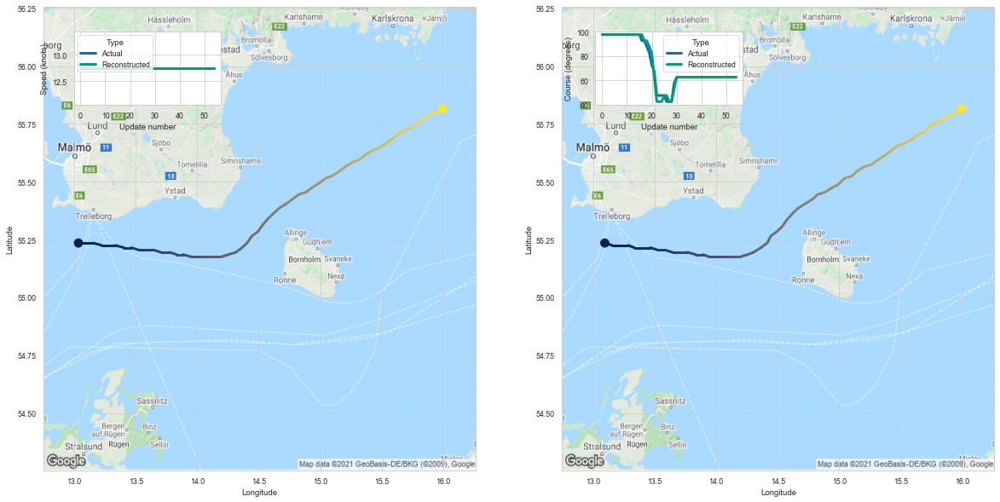

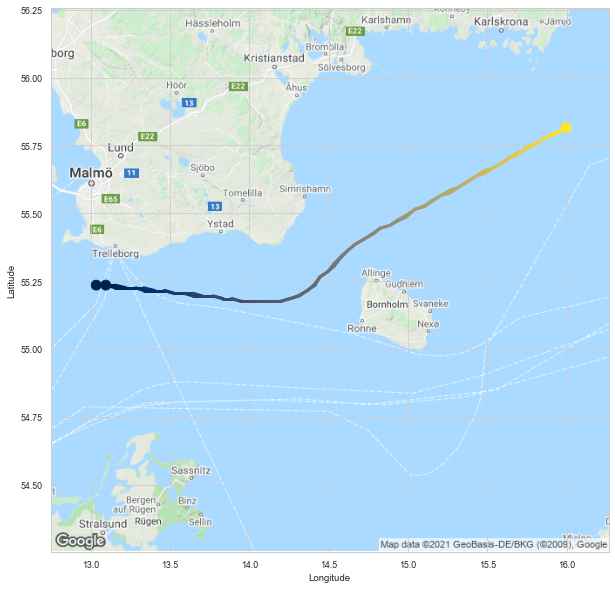

In [6]:
# Plot the actual and reconstructed trajectories side by side
data_info = data_infos["CargoTanker"]
tracks = plot_actual_reconstructed(2, data_info, data_set)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories_discrete.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories_discrete.plot_figures = False
visualise_trajectories_discrete.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories_discrete.plot_figures = plot_figures_tmp
visualise_trajectories_discrete.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

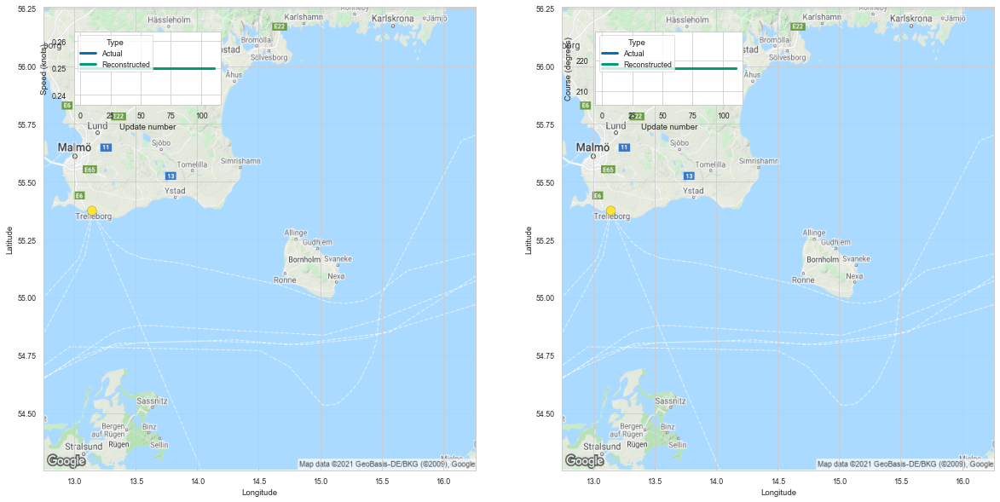

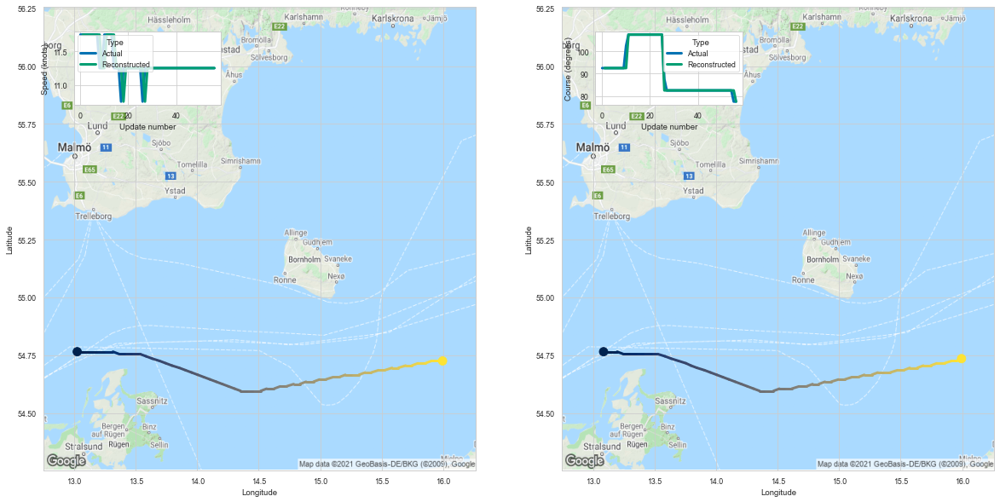

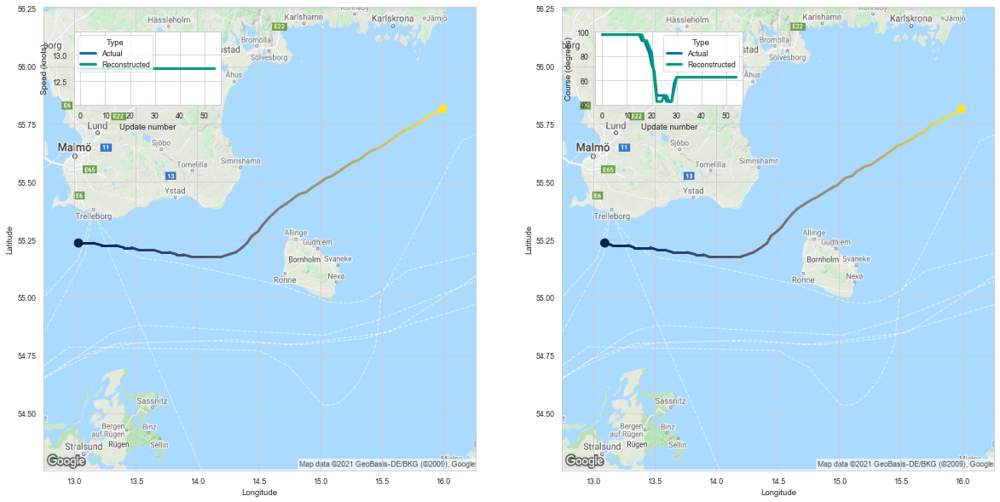

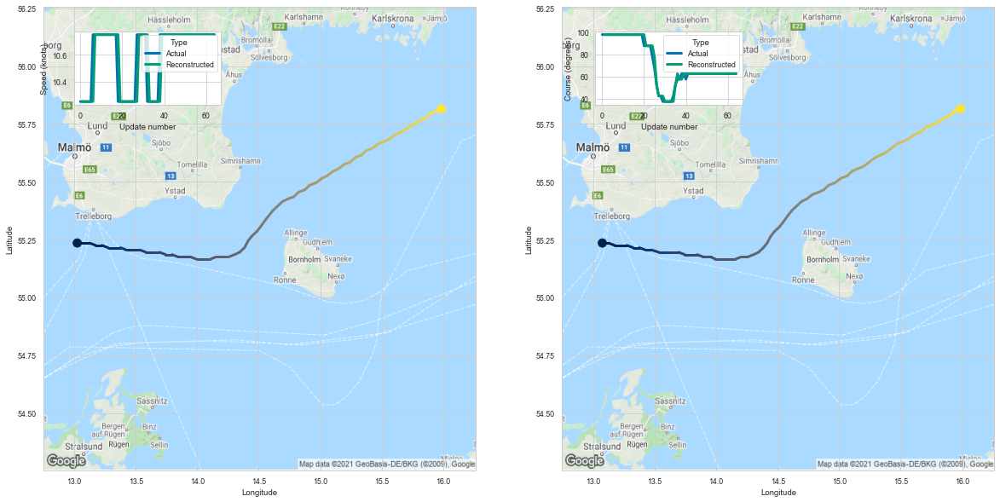

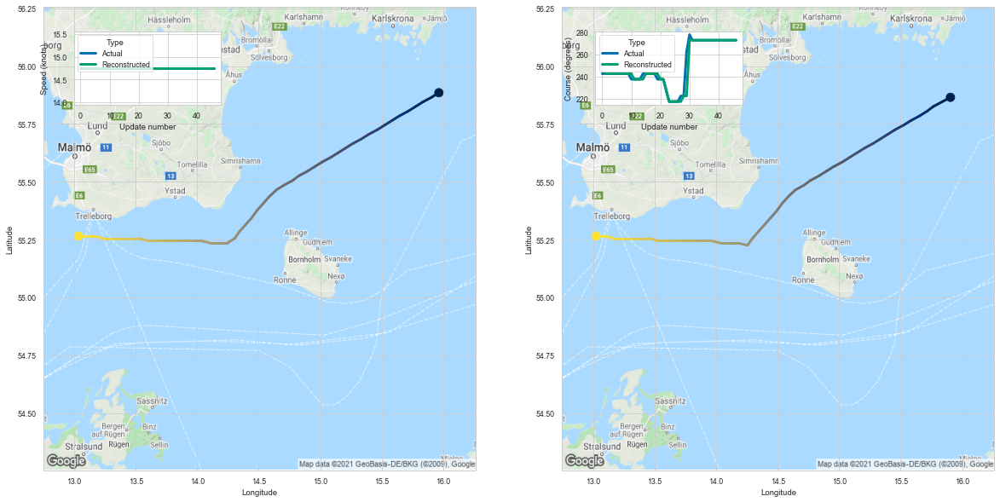

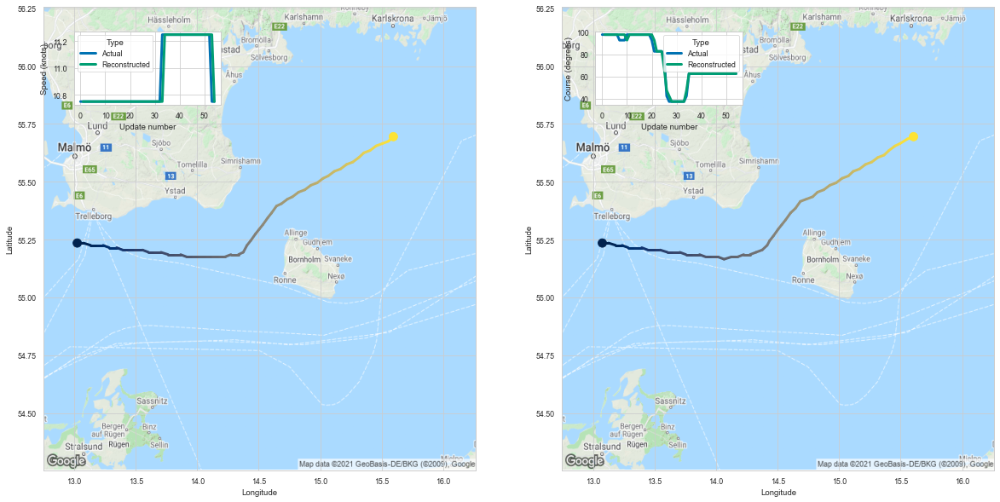

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
1634,1521,28301451,246724000,Cargo,112,-143.108078,-1.277751
357,244,54155606,371265000,Cargo,57,-204.682266,-3.590917
1554,1441,40308626,266247000,Cargo,55,-197.948700,-3.599067
1657,1544,37957629,258853000,Cargo,65,-236.752930,-3.642353
1377,1264,12166579,230350000,Cargo,47,-171.442947,-3.647722
898,785,48315538,305662000,Cargo,55,-200.754929,-3.650090


In [7]:
# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx, data_info, data_set)
df_n

# Worst Cargo Reconstructions

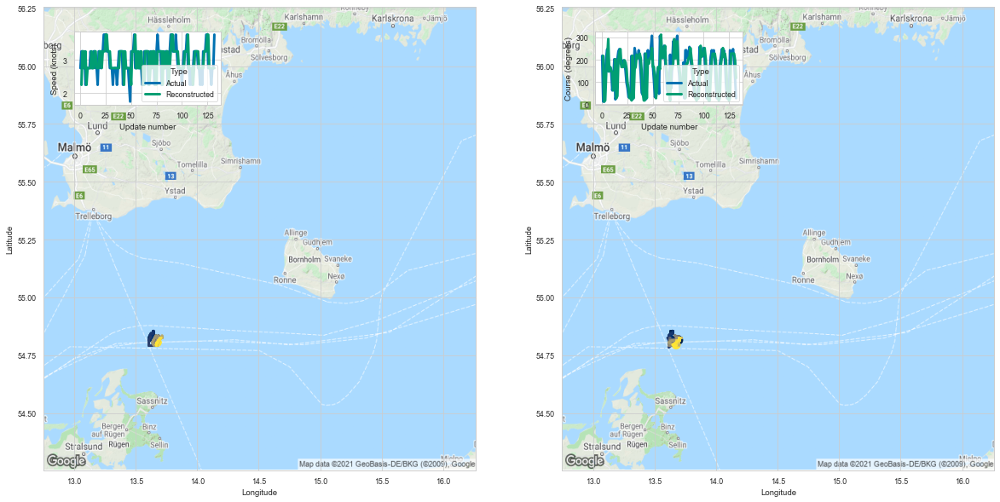

1-------------------------------------
HEAD:
    Longitude  Latitude  Speed  Course
1      13.695    54.815   2.25   217.5
2      13.625    54.835   3.25    12.5
3      13.625    54.855   3.25    17.5
4      13.645    54.855   2.75   142.5
5      13.615    54.835   3.25   212.5
6      13.615    54.835   2.25   292.5
7      13.615    54.825   2.75   147.5
8      13.615    54.825   2.75   167.5
9      13.615    54.815   2.75   152.5
10     13.615    54.815   2.75   142.5
   index  Speed    Type
0      0   2.75  Actual
1      1   3.25  Actual
2      2   3.25  Actual
3      3   2.75  Actual
4      4   3.25  Actual
     index  Speed           Type
133      1   2.25  Reconstructed
134      2   3.25  Reconstructed
135      3   3.25  Reconstructed
136      4   2.75  Reconstructed
137      5   3.25  Reconstructed
   index  Course    Type
0      0   217.5  Actual
1      1    12.5  Actual
2      2    12.5  Actual
3      3   142.5  Actual
4      4   212.5  Actual
     index  Course           Type


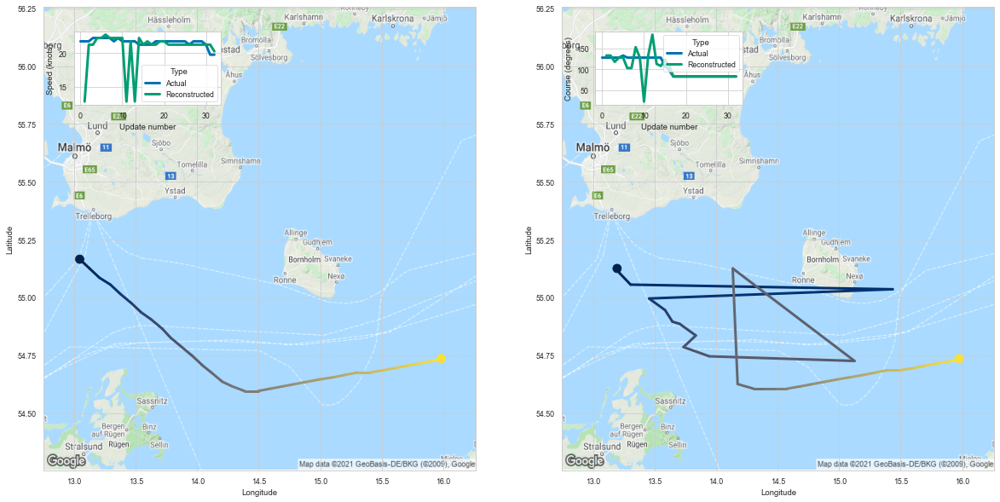

2-------------------------------------
HEAD:
    Longitude  Latitude  Speed  Course
1      13.195    55.125  12.75   132.5
2      13.215    55.105  21.25   132.5
3      13.305    55.055  21.25   117.5
4      15.435    55.035  22.25   127.5
5      13.455    54.995  22.25   127.5
6      13.585    54.945  22.75   102.5
7      13.645    54.895  22.25   102.5
8      13.705    54.885  22.25   152.5
9      13.835    54.835  22.25   127.5
10     13.735    54.785  22.25    22.5
   index  Speed    Type
0      0  21.75  Actual
1      1  21.75  Actual
2      2  21.75  Actual
3      3  22.25  Actual
4      4  22.25  Actual
    index  Speed           Type
33      1  12.75  Reconstructed
34      2  21.25  Reconstructed
35      3  21.25  Reconstructed
36      4  22.25  Reconstructed
37      5  22.25  Reconstructed
   index  Course    Type
0      0   127.5  Actual
1      1   127.5  Actual
2      2   127.5  Actual
3      3   127.5  Actual
4      4   127.5  Actual
    index  Course           Type
33     

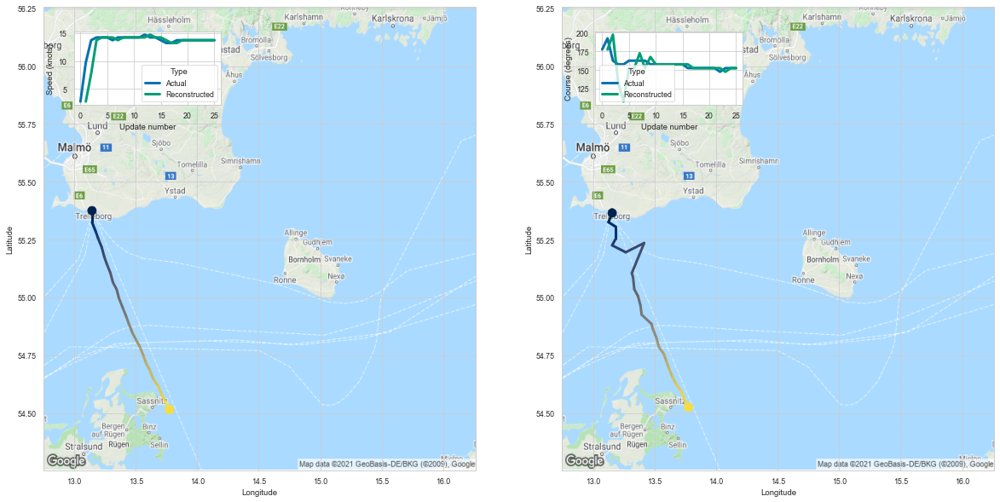

3-------------------------------------
HEAD:
    Longitude  Latitude  Speed  Course
1      13.155    55.365   2.75   177.5
2      13.125    55.325   7.75   197.5
3      13.185    55.305  13.75   132.5
4      13.185    55.255  14.25   107.5
5      13.155    55.225  14.25   152.5
6      13.265    55.195  14.25   152.5
7      13.415    55.235  13.75   172.5
8      13.315    55.105  14.25   152.5
9      13.325    55.085  14.25   167.5
10     13.335    55.035  14.25   157.5
   index  Speed    Type
0      0   2.75  Actual
1      1   9.75  Actual
2      2  13.75  Actual
3      3  14.25  Actual
4      4  14.25  Actual
    index  Speed           Type
26      1   2.75  Reconstructed
27      2   7.75  Reconstructed
28      3  13.75  Reconstructed
29      4  14.25  Reconstructed
30      5  14.25  Reconstructed
   index  Course    Type
0      0   177.5  Actual
1      1   192.5  Actual
2      2   162.5  Actual
3      3   157.5  Actual
4      4   157.5  Actual
    index  Course           Type
26     

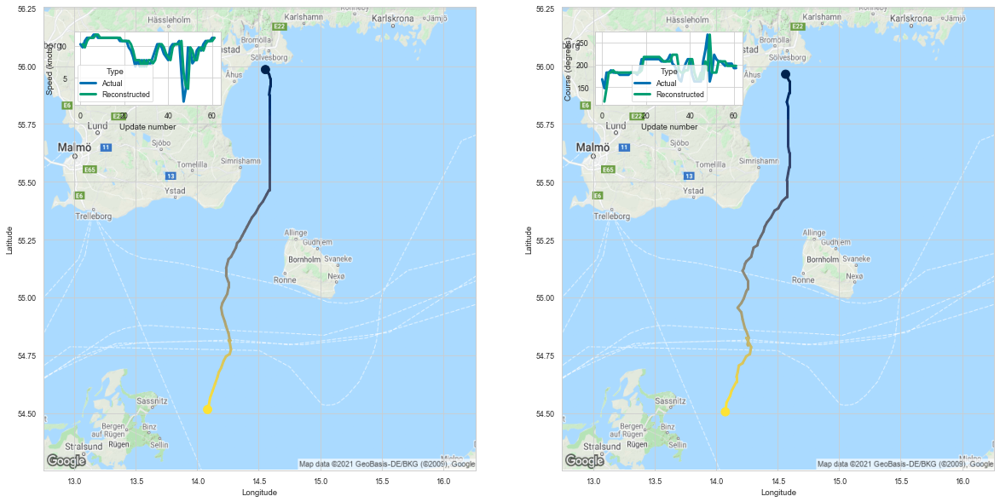

4-------------------------------------
HEAD:
    Longitude  Latitude  Speed  Course
1      14.565    55.965  10.25   117.5
2      14.595    55.935   9.75   147.5
3      14.595    55.925  10.75   182.5
4      14.595    55.885  11.25   182.5
5      14.575    55.845  11.25   187.5
6      14.585    55.825  11.25   182.5
7      14.585    55.785  11.75   182.5
8      14.585    55.755  11.75   182.5
9      14.585    55.725  11.25   182.5
10     14.585    55.765  11.25   182.5
   index  Speed    Type
0      0  10.25  Actual
1      1   9.75  Actual
2      2  10.75  Actual
3      3  11.25  Actual
4      4  11.25  Actual
    index  Speed           Type
62      1  10.25  Reconstructed
63      2   9.75  Reconstructed
64      3  10.75  Reconstructed
65      4  11.25  Reconstructed
66      5  11.25  Reconstructed
   index  Course    Type
0      0   167.5  Actual
1      1   147.5  Actual
2      2   182.5  Actual
3      3   182.5  Actual
4      4   187.5  Actual
    index  Course           Type
62     

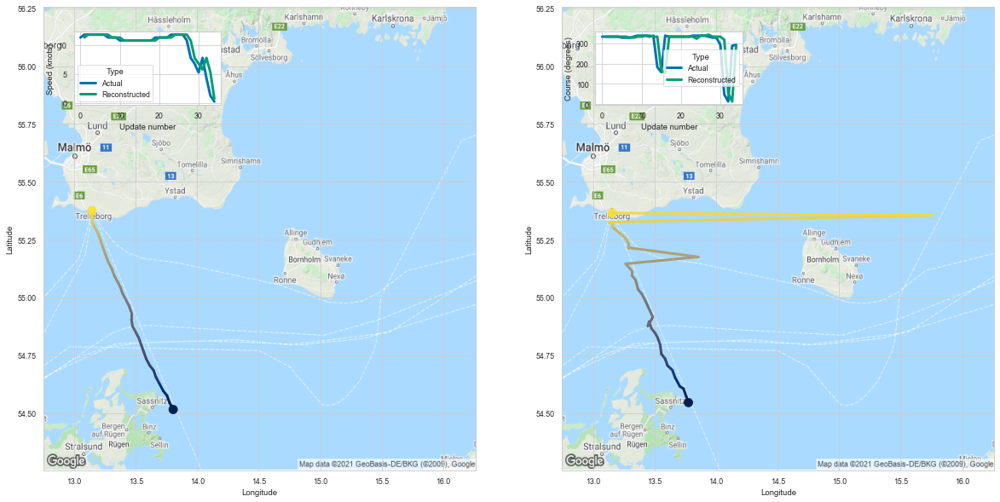

5-------------------------------------
HEAD:
    Longitude  Latitude  Speed  Course
1      13.775    54.545  11.25   332.5
2      13.755    54.575  11.75   332.5
3      13.735    54.605  11.75   332.5
4      13.705    54.615  11.75   332.5
5      13.665    54.655  11.75   332.5
6      13.645    54.685  11.75   332.5
7      13.605    54.705  11.75   327.5
8      13.585    54.735  11.25   327.5
9      13.555    54.755  11.25   332.5
10     13.545    54.795  11.25   332.5
   index  Speed    Type
0      0  11.25  Actual
1      1  11.75  Actual
2      2  11.75  Actual
3      3  11.75  Actual
4      4  11.75  Actual
    index  Speed           Type
35      1  11.25  Reconstructed
36      2  11.75  Reconstructed
37      3  11.75  Reconstructed
38      4  11.75  Reconstructed
39      5  11.75  Reconstructed
   index  Course    Type
0      0   332.5  Actual
1      1   332.5  Actual
2      2   332.5  Actual
3      3   332.5  Actual
4      4   332.5  Actual
    index  Course           Type
35     

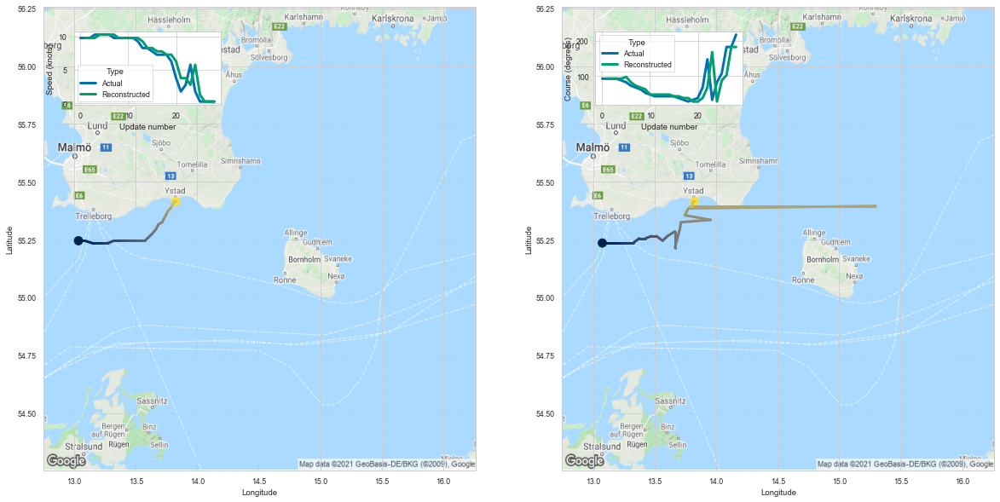

6-------------------------------------
HEAD:
    Longitude  Latitude  Speed  Course
1      13.075    55.235   9.75    92.5
2      13.135    55.235   9.75    92.5
3      13.205    55.235   9.75    92.5
4      13.225    55.235  10.25    92.5
5      13.275    55.235  10.25    97.5
6      13.325    55.235  10.25    82.5
7      13.375    55.255  10.25    72.5
8      13.425    55.255   9.75    67.5
9      13.475    55.265   9.75    62.5
10     13.515    55.265   9.75    47.5
   index  Speed    Type
0      0   9.75  Actual
1      1   9.75  Actual
2      2   9.75  Actual
3      3  10.25  Actual
4      4  10.25  Actual
    index  Speed           Type
29      1   9.75  Reconstructed
30      2   9.75  Reconstructed
31      3   9.75  Reconstructed
32      4  10.25  Reconstructed
33      5  10.25  Reconstructed
   index  Course    Type
0      0    92.5  Actual
1      1    92.5  Actual
2      2    92.5  Actual
3      3    92.5  Actual
4      4    87.5  Actual
    index  Course           Type
29     

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
471,358,8666252,218862000,Cargo,133,-1771.164062,-13.317023
1374,1261,10369915,220464000,Cargo,33,-427.057922,-12.941149
1692,1579,39253403,265365000,Cargo,26,-330.372192,-12.706623
771,658,24144975,245180000,Cargo,62,-778.187866,-12.551417
1470,1357,37893265,258829000,Cargo,35,-435.319244,-12.437693
1582,1469,50617955,311000714,Cargo,29,-351.599915,-12.124135


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True, vessel_type=vessel_type)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]
data_set = train_evaluate.validation_dataloader.dataset.datasets[data_set_i]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx, data_info, data_set)
    print(f"{idx+1}-------------------------------------")
    print("HEAD:")
    print(tracks["Reconstructed trajectory"].head(10))
    print(tracks["Speed data frame"][tracks["Speed data frame"]["Type"] =="Actual"].head(5))
    print(tracks["Speed data frame"][tracks["Speed data frame"]["Type"] =="Reconstructed"].head(5))
    print(tracks["Course data frame"][tracks["Course data frame"]["Type"] =="Actual"].head(5))
    print(tracks["Course data frame"][tracks["Course data frame"]["Type"] =="Reconstructed"].head(5))
    print("TAIL:")
    print(tracks["Reconstructed trajectory"].tail(10))
    print(tracks["Speed data frame"][tracks["Speed data frame"]["Type"] =="Actual"].tail(5))
    print(tracks["Speed data frame"][tracks["Speed data frame"]["Type"] =="Reconstructed"].tail(5))
    print(tracks["Course data frame"][tracks["Course data frame"]["Type"] =="Actual"].tail(5))
    print(tracks["Course data frame"][tracks["Course data frame"]["Type"] =="Reconstructed"].tail(5))
df_n

# Worst n=25 Cargo Reconstructions

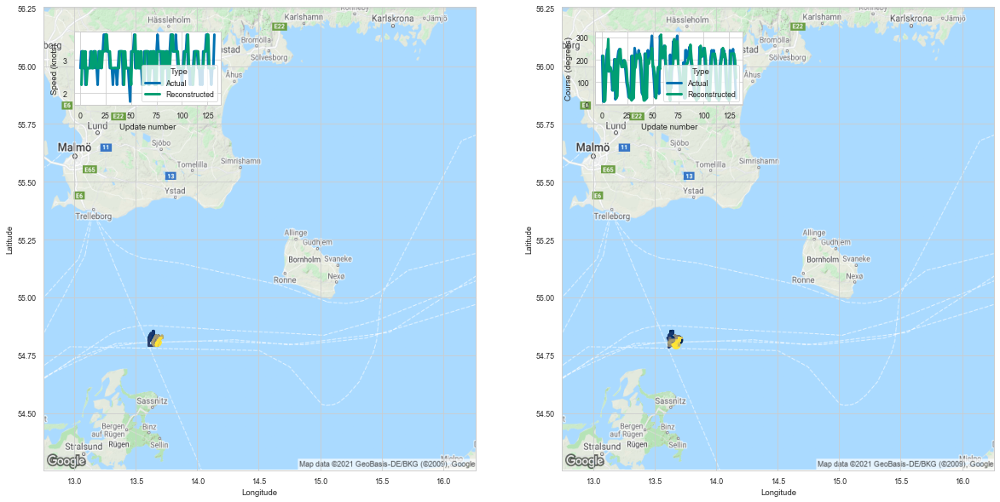

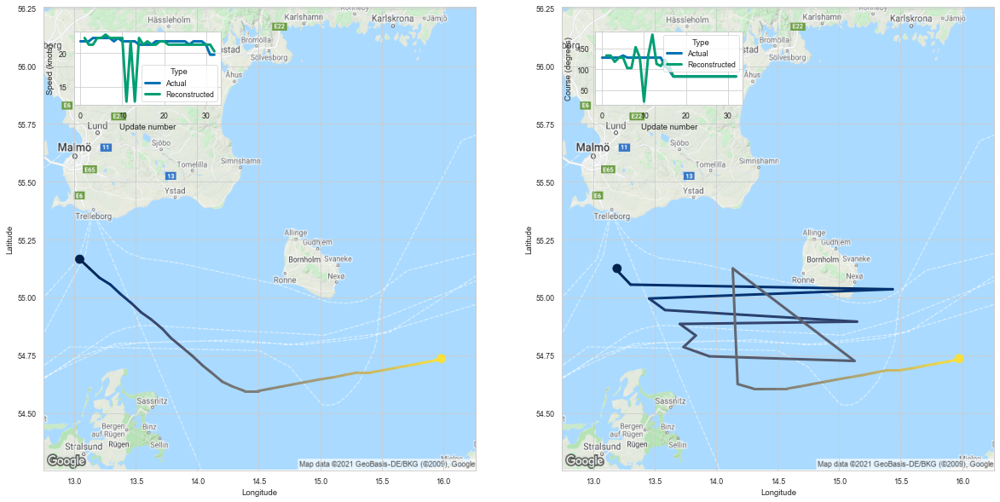

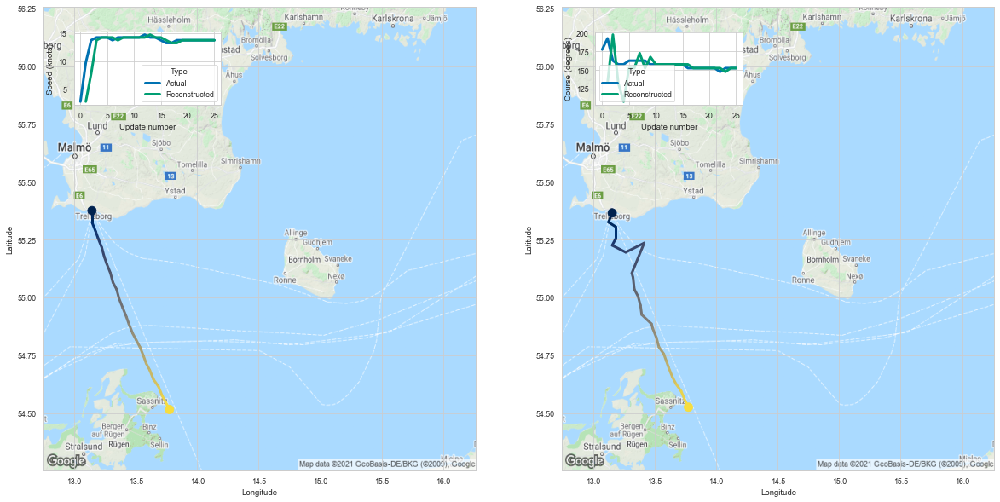

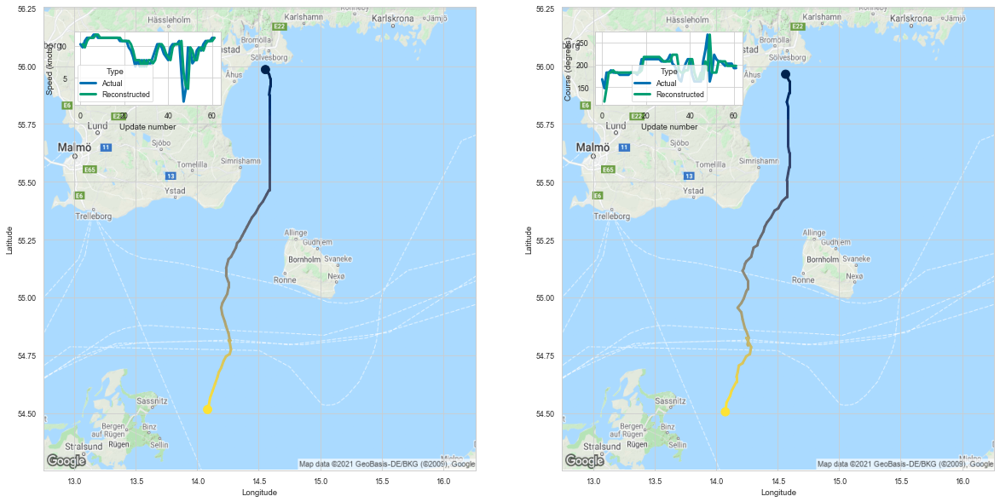

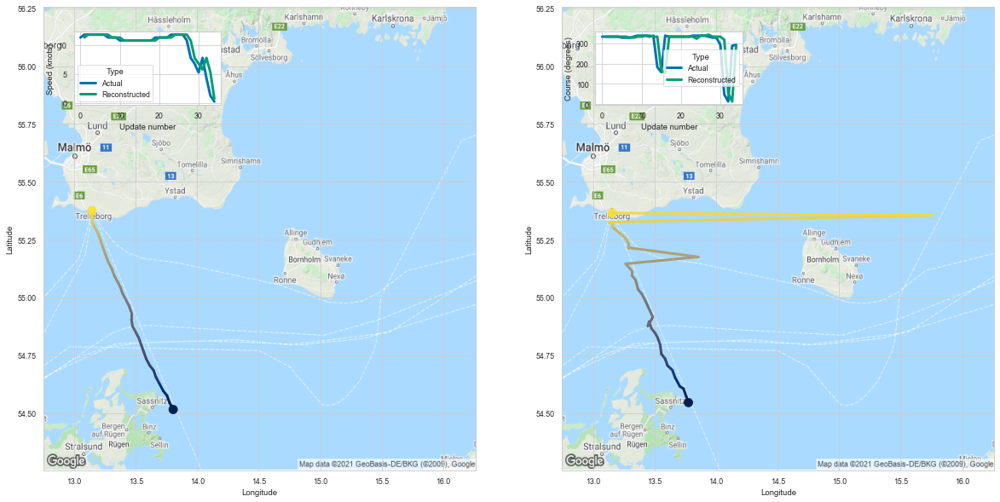

...

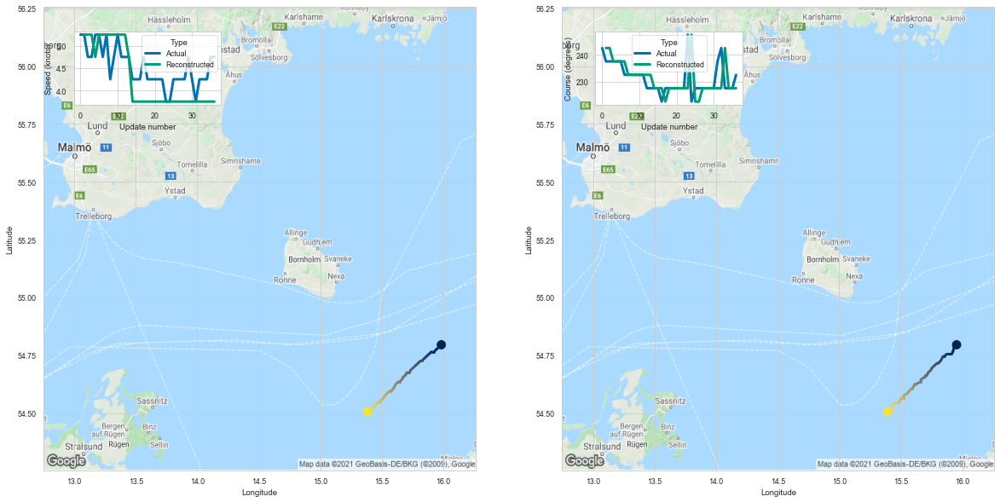

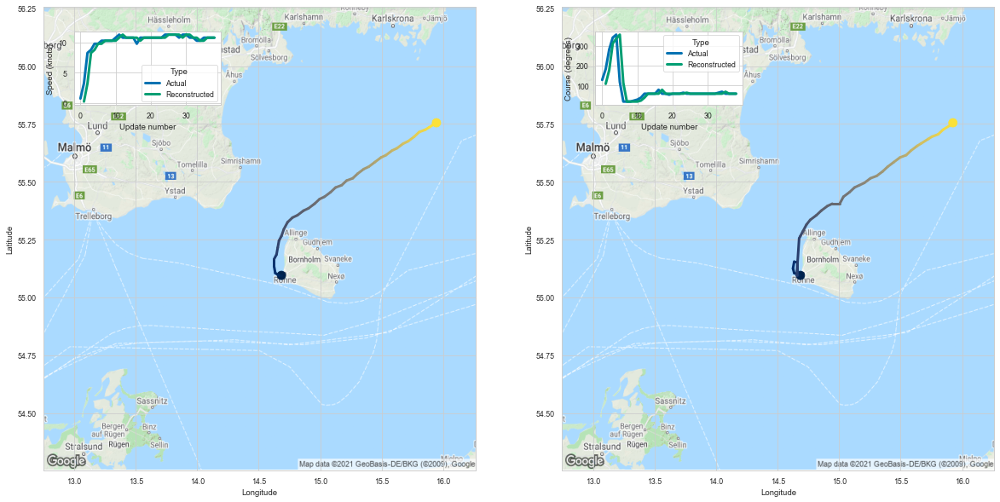

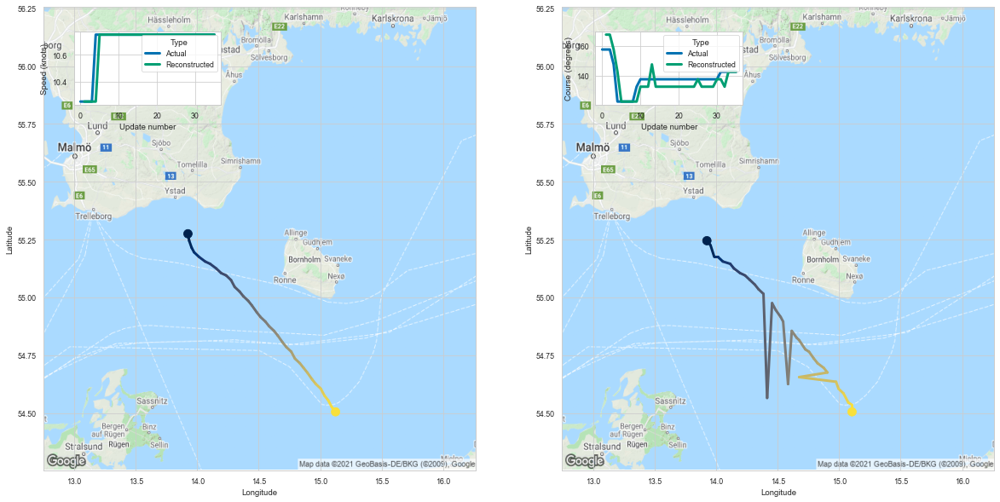

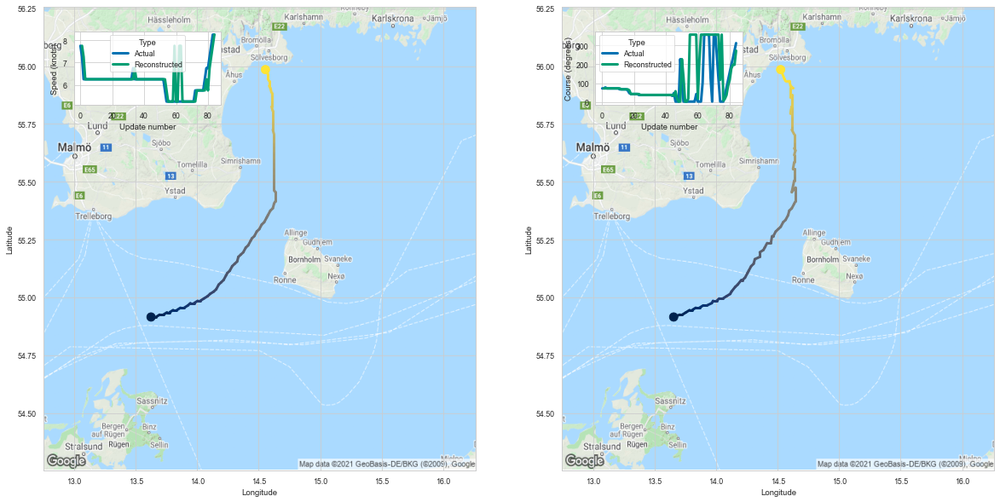

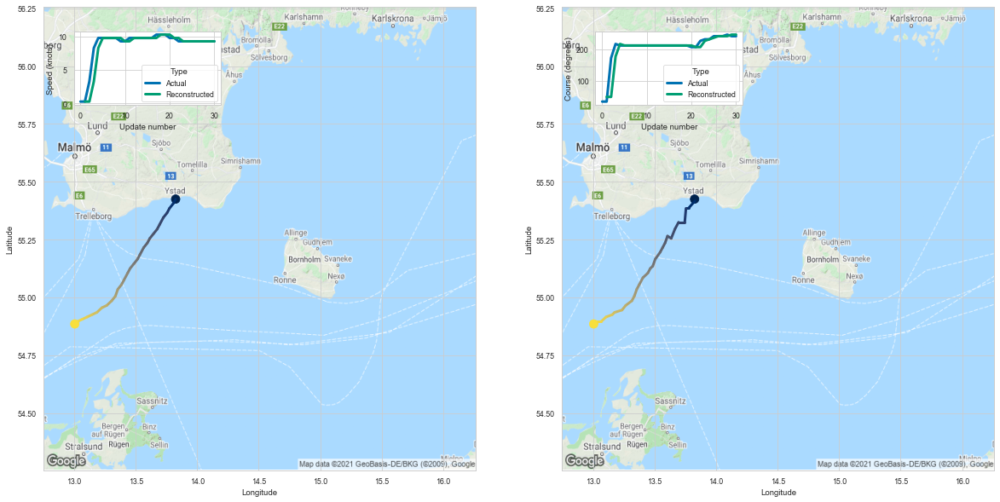

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
471,358,8666252,218862000,Cargo,133,-1771.325562,-13.318237
1374,1261,10369915,220464000,Cargo,33,-427.210449,-12.945771
1692,1579,39253403,265365000,Cargo,26,-330.163605,-12.698600
771,658,24144975,245180000,Cargo,62,-777.974854,-12.547982
1470,1357,37893265,258829000,Cargo,35,-435.218140,-12.434804
1582,1469,50617955,311000714,Cargo,29,-351.649475,-12.125844
131,18,62630736,636016233,Cargo,51,-606.249878,-11.887253
463,350,44594593,304218000,Cargo,115,-1340.980591,-11.660701
1769,1656,3569954,211234480,Cargo,27,-309.428619,-11.460319
1056,943,17741242,236205000,Cargo,53,-602.287292,-11.363911


In [9]:
# Focus on the n=25 worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=25, worst=True, vessel_type=vessel_type)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]
data_set = train_evaluate.validation_dataloader.dataset.datasets[data_set_i]

# Plot the actual and reconstructed trajectories side by side
for idx in range(25): 
    tracks = plot_actual_reconstructed(idx, data_info, data_set)
df_n

# Best Fishing Reconstructions

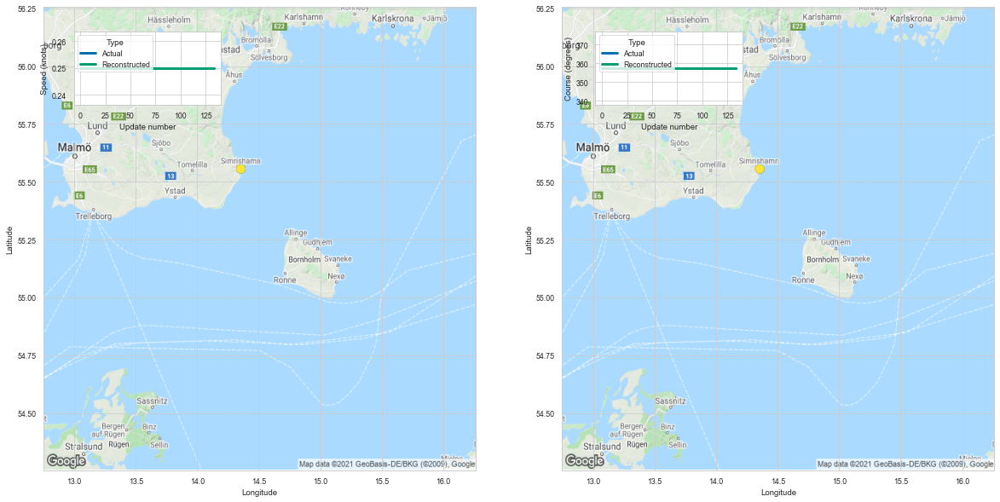

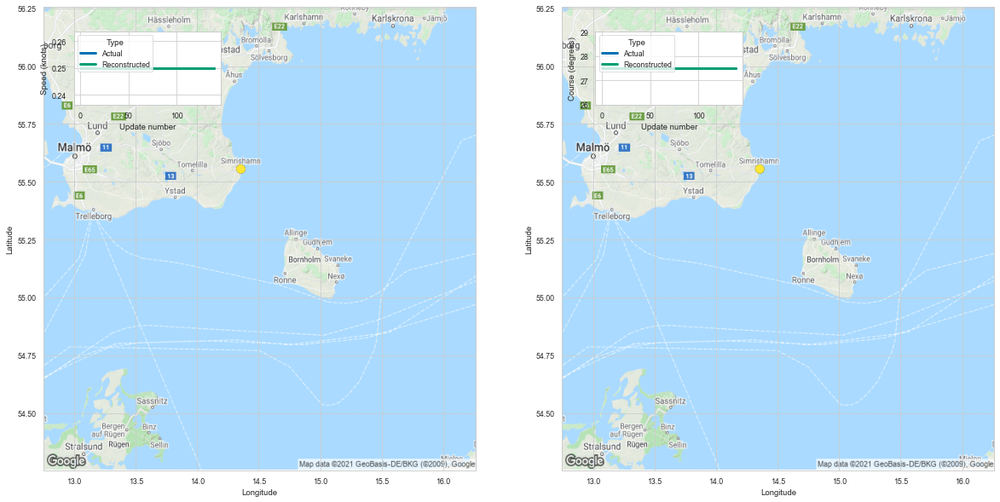

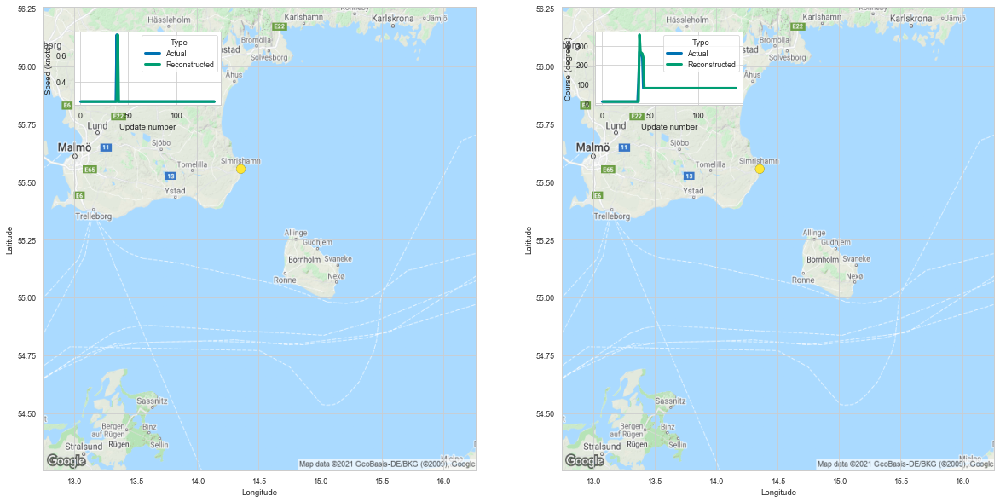

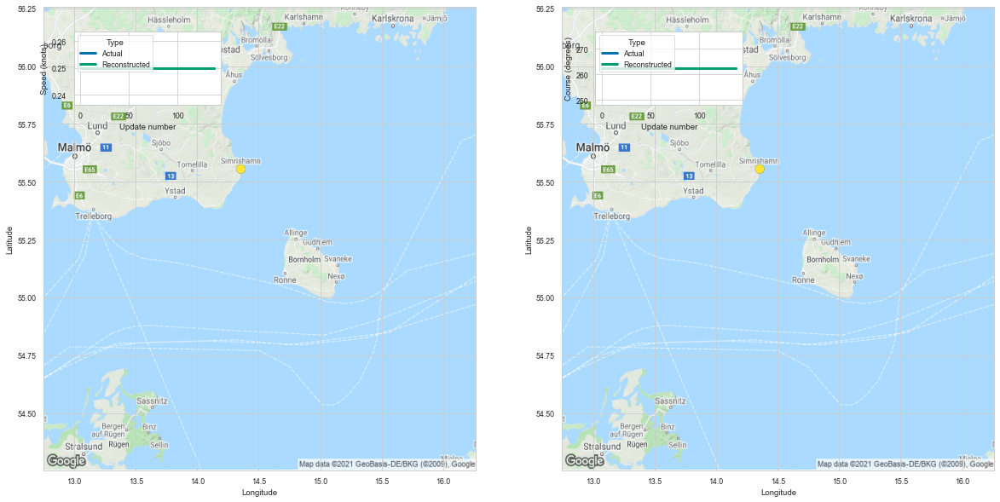

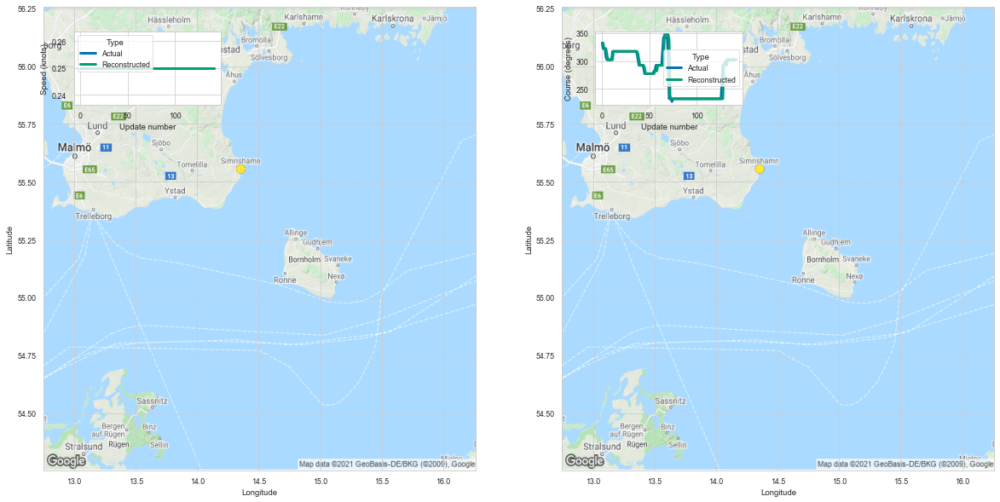

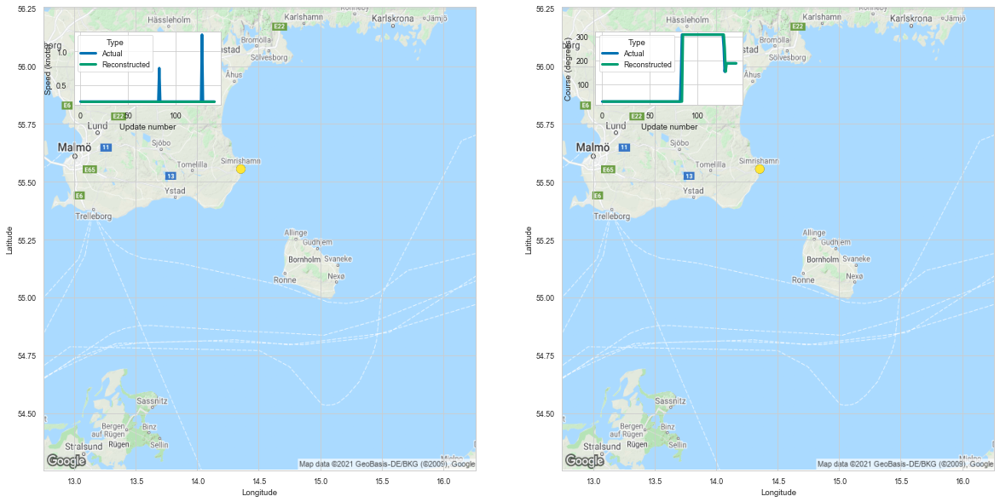

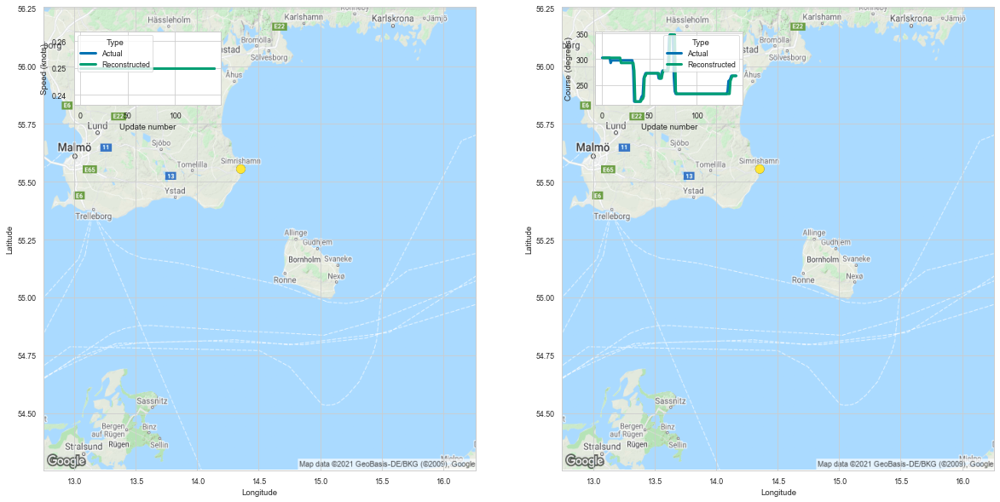

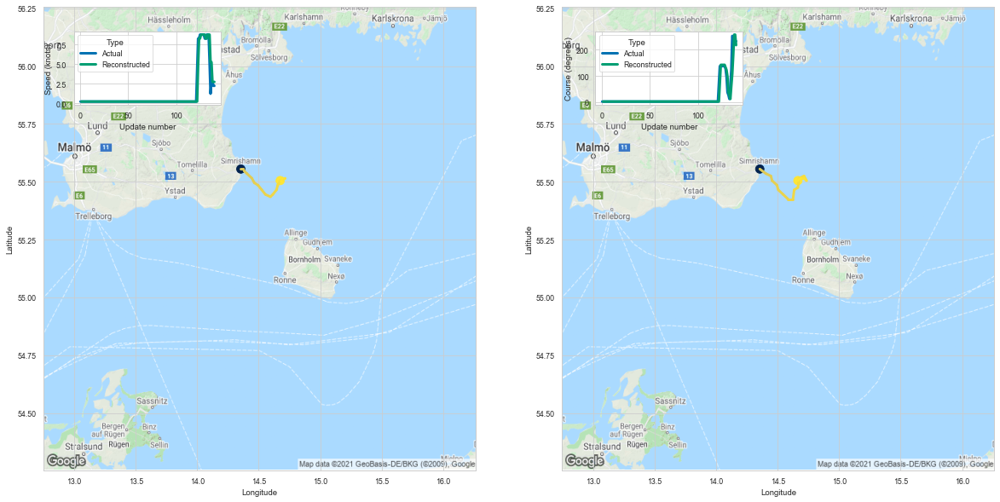

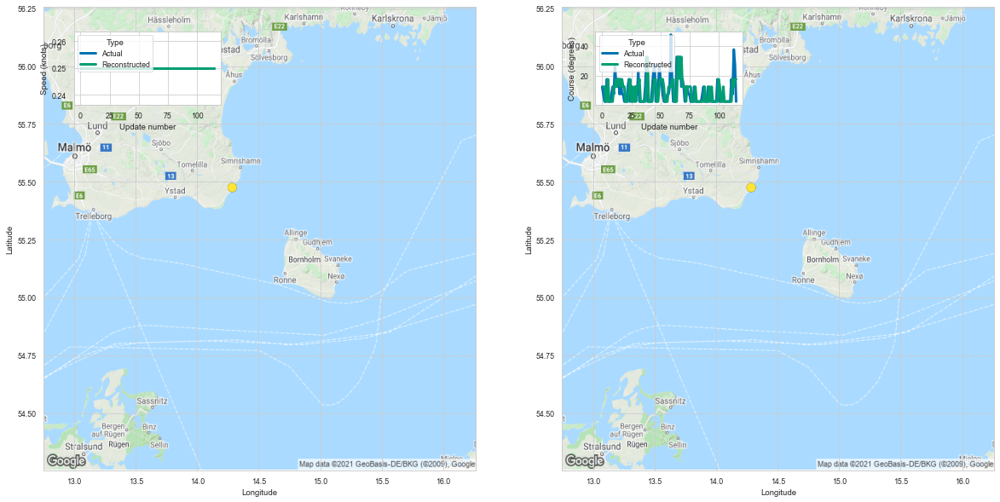

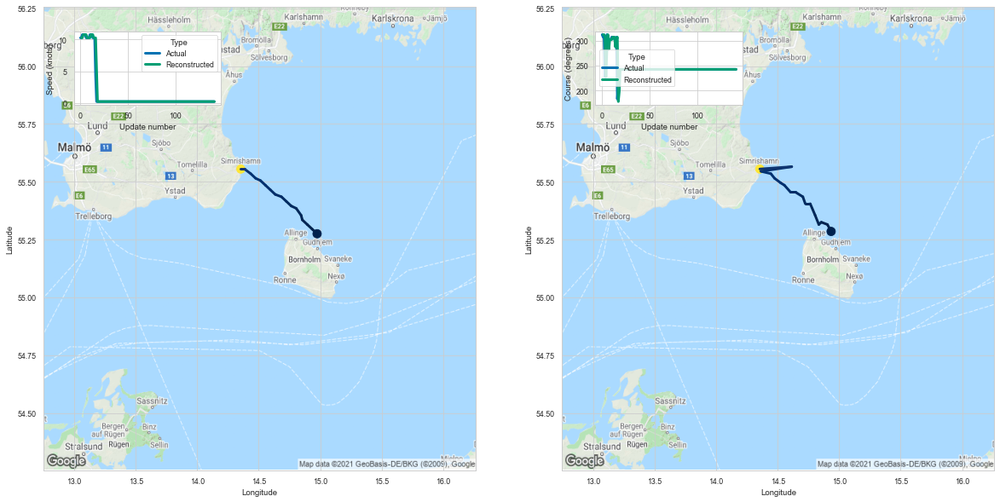

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
100,100,1583421,219021428,Fishing,135,-36.662575,-0.271575
52,52,5635000,265750000,Fishing,140,-87.696297,-0.626402
85,85,6525750,265755000,Fishing,141,-141.759399,-1.005386
43,43,5760657,265750000,Fishing,139,-145.537323,-1.047031
42,42,5972813,265754000,Fishing,143,-232.227280,-1.623967
76,76,5480216,265750000,Fishing,142,-240.084015,-1.690732
103,103,6064863,265754000,Fishing,143,-263.361725,-1.841690
11,11,6489434,265755000,Fishing,141,-373.298584,-2.647508
57,57,4868710,265551874,Fishing,116,-336.694214,-2.902536
84,84,5461932,265750000,Fishing,142,-474.376099,-3.340677


In [10]:
# Focus on the n best fishing reconstructions
vessel_type = "Fishing"
data_info = data_infos[vessel_type]
data = summary_models.run_evaluation_get_n(n=10, worst=False, vessel_type=vessel_type)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]
data_set_i = 1 if vessel_type == "Cargo" else 0
data_set = train_evaluate.validation_dataloader.dataset.datasets[data_set_i]

# Plot the actual and reconstructed trajectories side by side
for idx in range(10): 
    tracks = plot_actual_reconstructed(idx, data_info, data_set)
df_n

# Worst Fishing Reconstructions

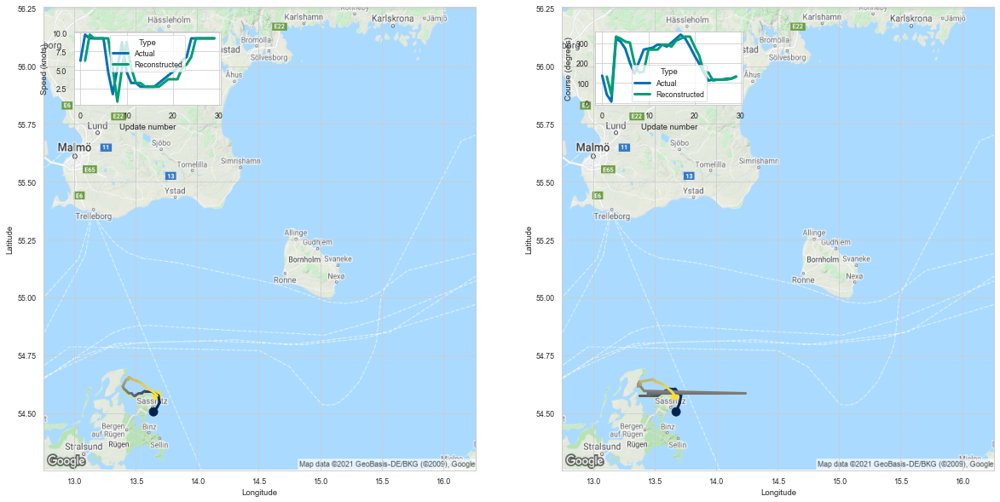

HEAD:
    Longitude  Latitude  Speed  Course
1      13.675    54.505   6.25   132.5
2      13.705    54.545   9.75    42.5
3      13.715    54.575   9.25   332.5
4      13.665    54.605   9.25   322.5
5      13.625    54.605   9.25   307.5
6      13.585    54.595   9.25   302.5
7      13.575    54.585   5.25   197.5
8      13.585    54.595   0.75   152.5
9      13.525    54.575   5.25   157.5
10     13.485    54.575   8.75   267.5
TAIL:
    Longitude  Latitude  Speed  Course
20     13.375    54.635   3.75   282.5
21     13.385    54.625   3.75   237.5
22     13.385    54.635   5.25   157.5
23     13.385    54.635   5.75   152.5
24     13.485    54.645   6.75   112.5
25     13.515    54.635   9.25   117.5
26     13.565    54.625   9.25   117.5
27     13.585    54.615   9.25   117.5
28     13.635    54.595   9.25   122.5
29     13.665    54.575   9.25   132.5


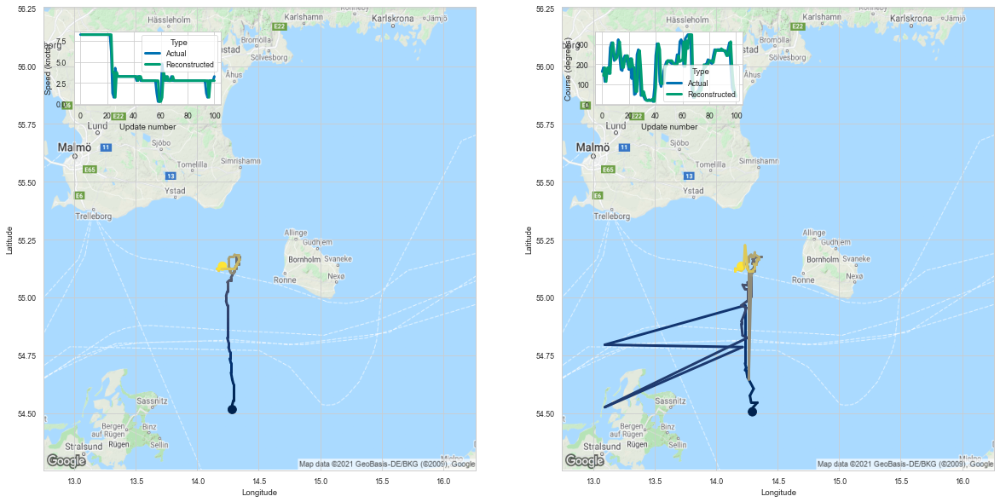

HEAD:
    Longitude  Latitude  Speed  Course
1      14.295    54.505   8.25   142.5
2      14.285    54.515   8.25   182.5
3      14.335    54.545   8.25   112.5
4      14.285    54.545   8.25   182.5
5      14.275    54.575   8.25   182.5
6      14.305    54.605   8.25   152.5
7      14.255    54.655   8.25   282.5
8      14.245    54.685   8.25   307.5
9      14.235    54.685   8.25   252.5
10     14.245    54.695   8.25   222.5
TAIL:
     Longitude  Latitude  Speed  Course
91      14.155    55.125   2.75   267.5
92      14.155    55.115   2.75   267.5
93      14.155    55.115   2.75   242.5
94      14.155    55.115   2.75   242.5
95      14.155    55.125   2.75   277.5
96      14.155    55.125   0.75   312.5
97      14.155    55.115   2.75   182.5
98      14.185    55.125   2.75    97.5
99      14.205    55.125   2.75    62.5
100     14.205    55.135   2.75    42.5


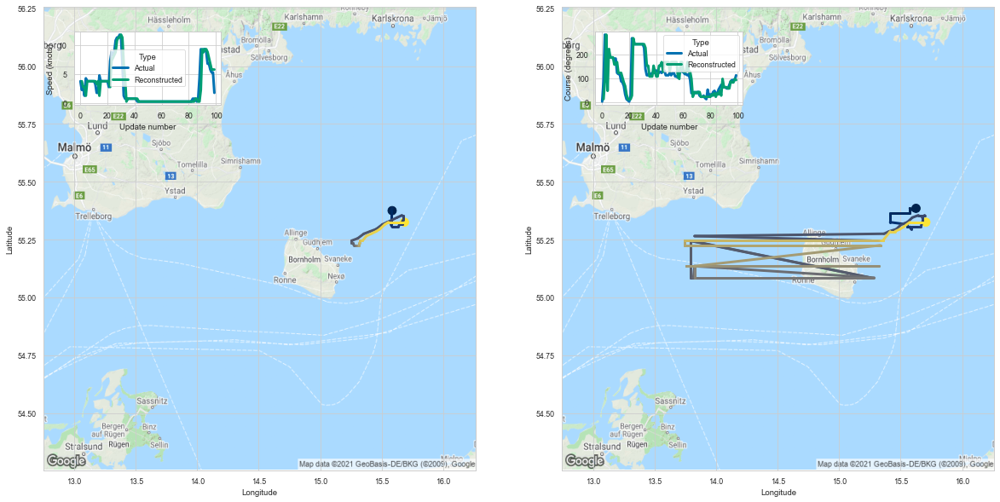

HEAD:
    Longitude  Latitude  Speed  Course
1      15.625    55.385   3.75    12.5
2      15.605    55.375   2.75    87.5
3      15.575    55.385   2.75   282.5
4      15.575    55.375   1.25    47.5
5      15.575    55.365   3.75   222.5
6      15.415    55.365   3.75   187.5
7      15.415    55.345   3.75   187.5
8      15.415    55.345   3.75   187.5
9      15.415    55.325   3.75   157.5
10     15.555    55.315   3.75   157.5
TAIL:
    Longitude  Latitude  Speed  Course
90     15.415    55.285   9.25    62.5
91     15.455    55.285   8.75    62.5
92     15.495    55.295   9.25    62.5
93     15.525    55.305   9.25    57.5
94     15.575    55.325   8.75    57.5
95     15.575    55.325   7.75    87.5
96     15.625    55.325   6.75    82.5
97     15.665    55.325   5.75    82.5
98     15.675    55.325   5.75    97.5
99     15.705    55.325   5.75    92.5


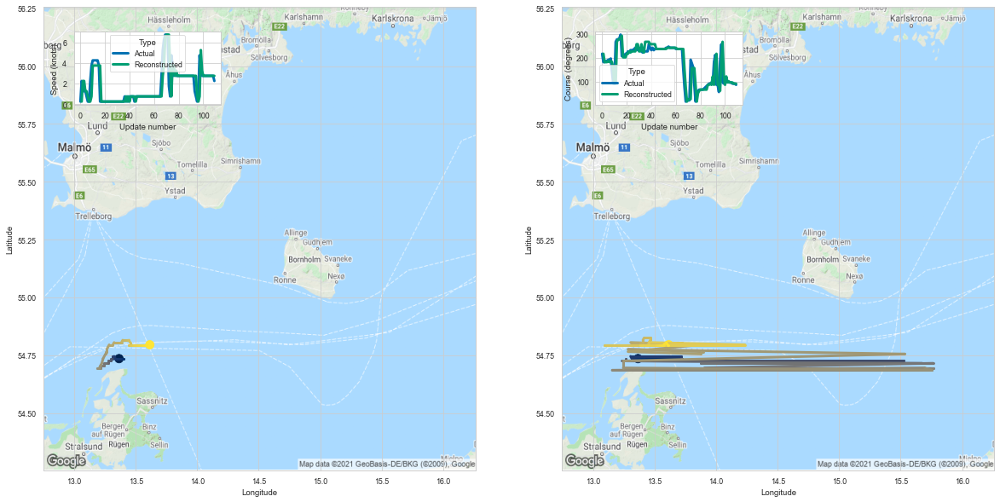

HEAD:
    Longitude  Latitude  Speed  Course
1      13.365    54.735   0.25   217.5
2      13.365    54.735   2.25   182.5
3      13.345    54.735   2.25   182.5
4      13.345    54.735   1.25   182.5
5      13.345    54.735   1.25   187.5
6      13.345    54.725   0.75   182.5
7      13.345    54.735   0.25   187.5
8      13.725    54.735   0.25   182.5
9      13.325    54.735   0.75   157.5
10     13.415    54.735   3.75    92.5
TAIL:
     Longitude  Latitude  Speed  Course
100     13.505    54.795   2.75    87.5
101     13.515    54.795   2.75   122.5
102     13.525    54.795   2.75    97.5
103     13.535    54.795   2.75   102.5
104     13.545    54.795   2.75    97.5
105     13.555    54.795   2.75    97.5
106     13.575    54.795   2.75    97.5
107     13.595    54.805   2.75    92.5
108     13.605    54.795   2.75    92.5
109     13.615    54.795   2.75    92.5


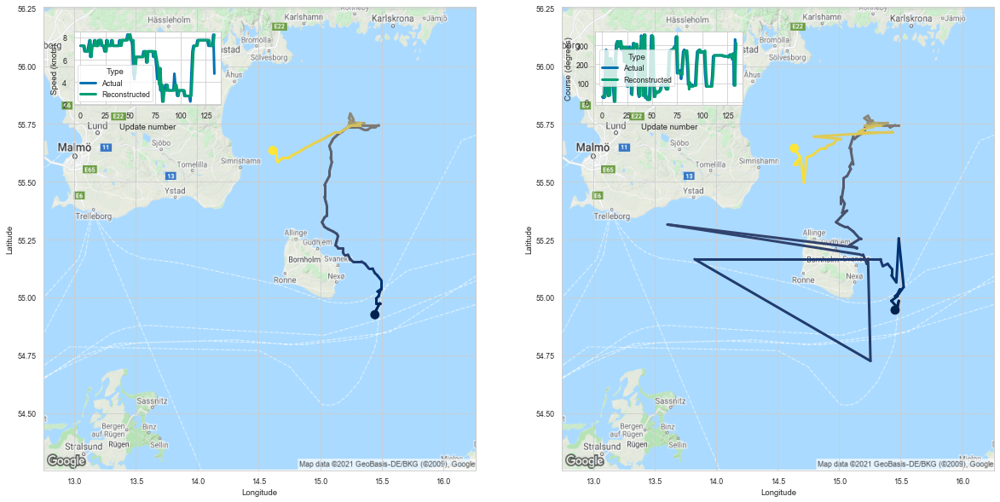

HEAD:
    Longitude  Latitude  Speed  Course
1      15.455    54.945   7.25    32.5
2      15.475    54.965   7.25    32.5
3      15.485    54.985   7.25    27.5
4      15.475    54.955   7.25   192.5
5      15.425    54.985   6.75   267.5
6      15.475    55.005   6.75    52.5
7      15.485    55.025   6.75    32.5
8      15.495    55.035   6.75    37.5
9      15.475    55.015   7.25   232.5
10     15.455    55.005   7.75   212.5
TAIL:
     Longitude  Latitude  Speed  Course
125     14.855    55.645   7.75   242.5
126     14.805    55.625   7.75   242.5
127     14.785    55.615   7.75   237.5
128     14.735    55.605   7.75   242.5
129     14.715    55.495   7.75   252.5
130     14.685    55.605   7.25   247.5
131     14.655    55.575   7.25   227.5
132     14.635    55.575   7.25   257.5
133     14.685    55.605   7.25    87.5
134     14.635    55.645   8.25   312.5


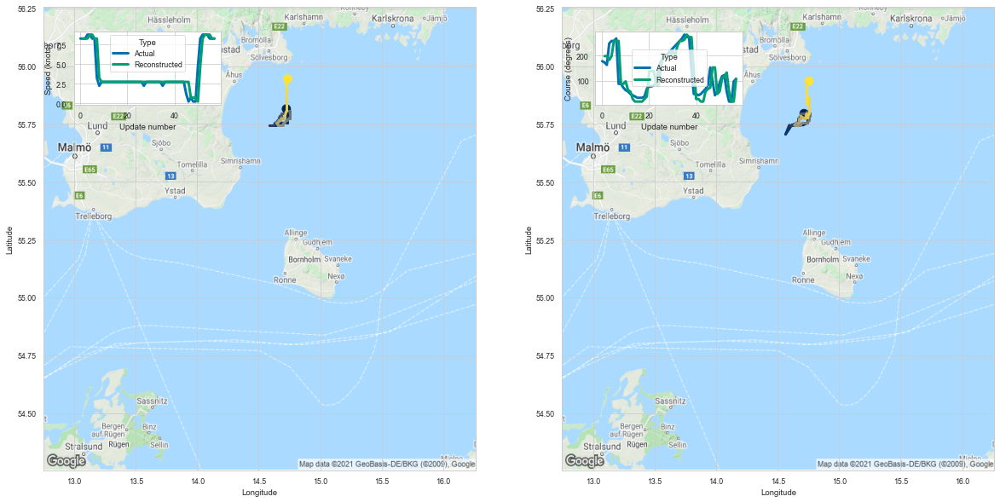

HEAD:
    Longitude  Latitude  Speed  Course
1      14.715    55.795   8.25   197.5
2      14.745    55.775   8.25   197.5
3      14.745    55.755   8.25   182.5
4      14.705    55.745   8.75   197.5
5      14.665    55.755   8.75   257.5
6      14.615    55.745   8.25   257.5
7      14.565    55.705   8.25   257.5
8      14.595    55.745   3.25    87.5
9      14.605    55.745   2.75    87.5
10     14.615    55.745   2.75    97.5
TAIL:
    Longitude  Latitude  Speed  Course
48     14.725    55.775   0.75   152.5
49     14.735    55.795   0.75    47.5
50     14.735    55.785   0.25    57.5
51     14.745    55.775   4.75   107.5
52     14.755    55.795   8.25   117.5
53     14.755    55.815   8.75   132.5
54     14.755    55.865   8.75    57.5
55     14.735    55.835   8.75    17.5
56     14.735    55.935   8.25    17.5
57     14.755    55.935   8.25   107.5


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
73,73,1113112,211542610,Fishing,30,-492.863739,-16.428791
48,48,4303656,261007170,Fishing,101,-1556.811035,-15.413971
5,5,6496,211215500,Fishing,100,-1434.803467,-14.348035
21,21,19488,211243240,Fishing,110,-1563.403564,-14.212760
49,49,1557318,219021428,Fishing,135,-1871.340088,-13.861778
38,38,4942336,265593190,Fishing,58,-734.382446,-12.661766


In [11]:
# Focus on the n worst fishing reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True, vessel_type=vessel_type)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]
data_set = train_evaluate.validation_dataloader.dataset.datasets[data_set_i]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx, data_info, data_set)
    print("HEAD:")
    print(tracks['Reconstructed trajectory'].head(10))
    print("TAIL:")
    print(tracks['Reconstructed trajectory'].tail(10))
df_n

# Worst n=25 fishing Reconstructions

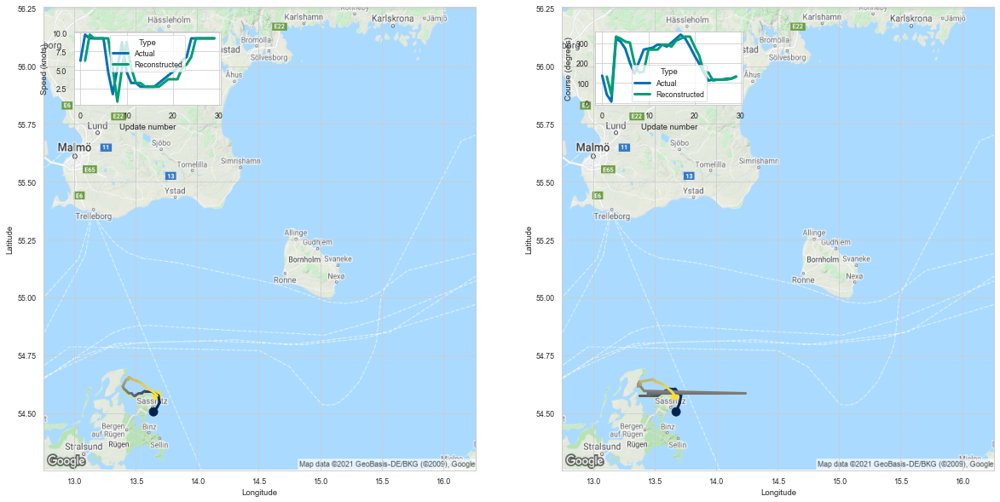

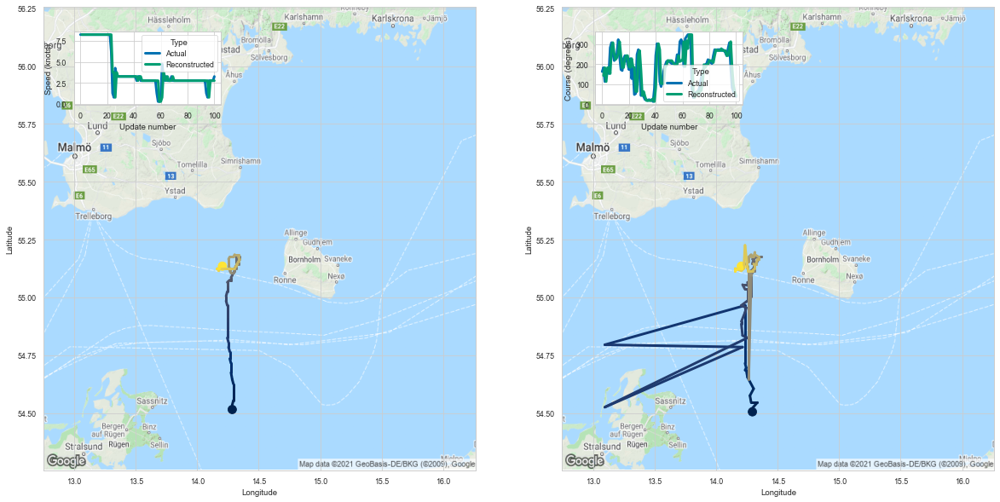

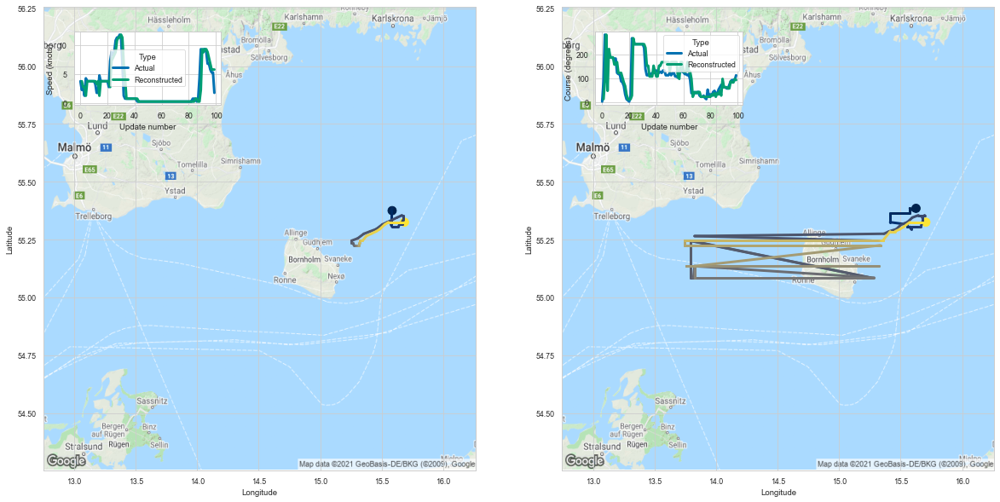

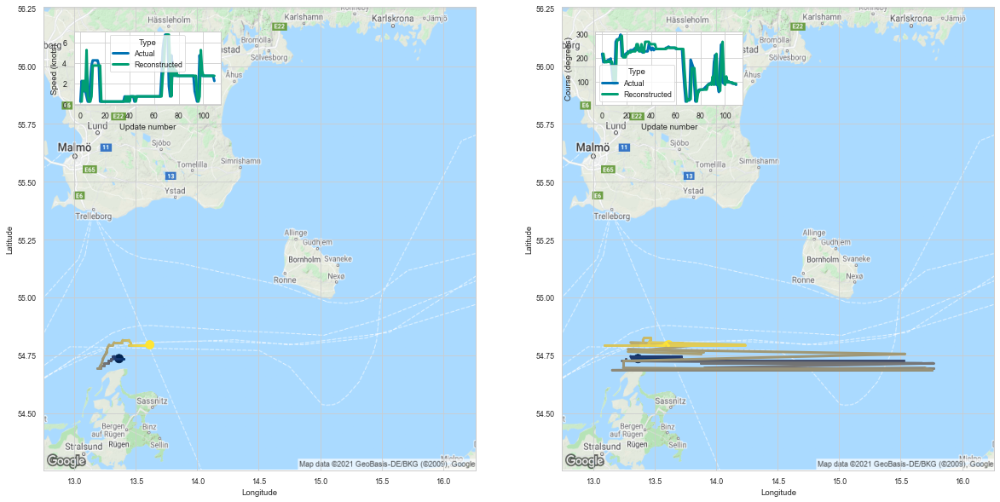

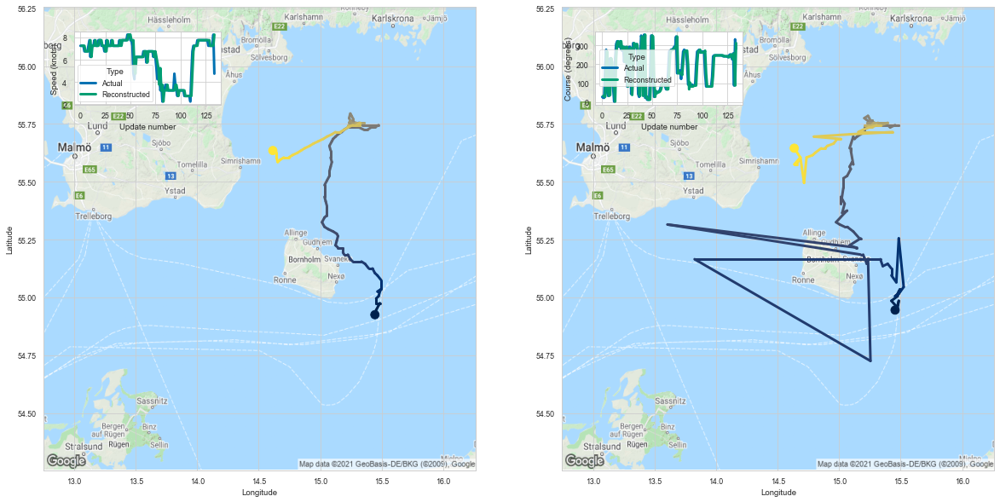

...

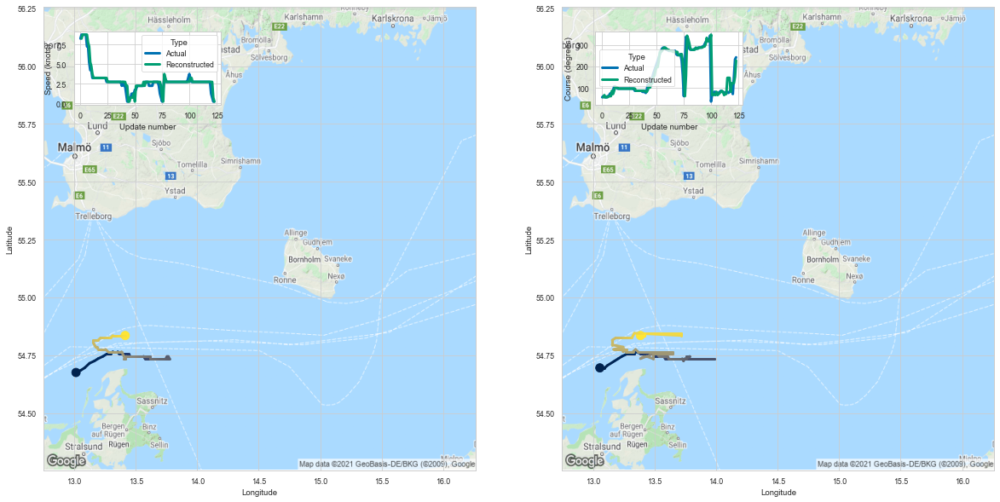

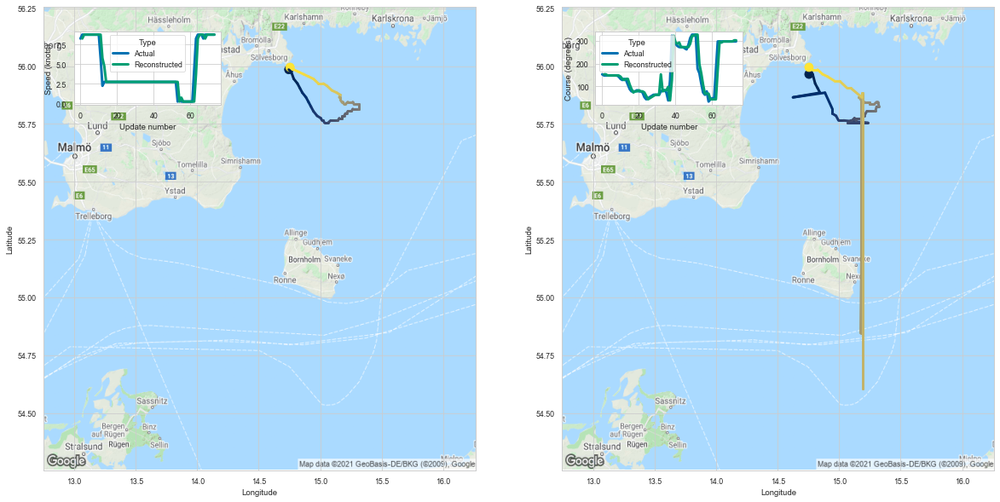

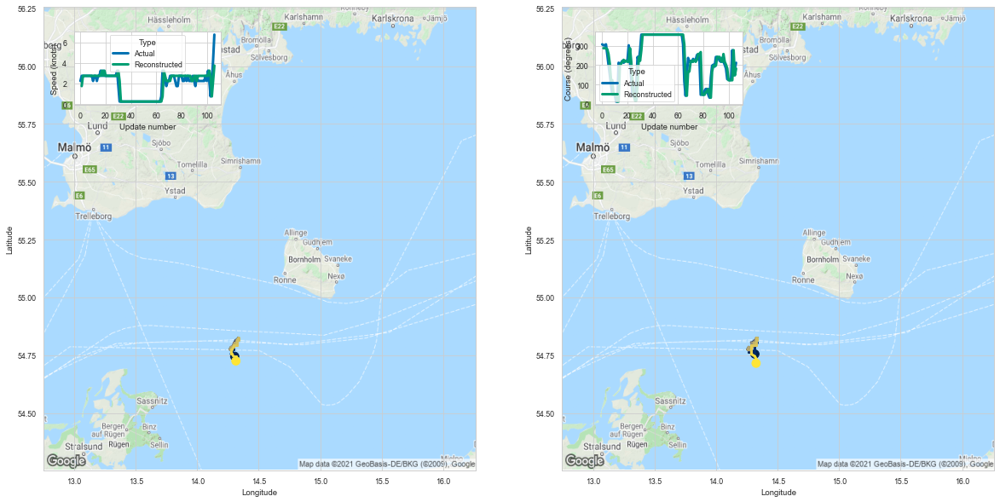

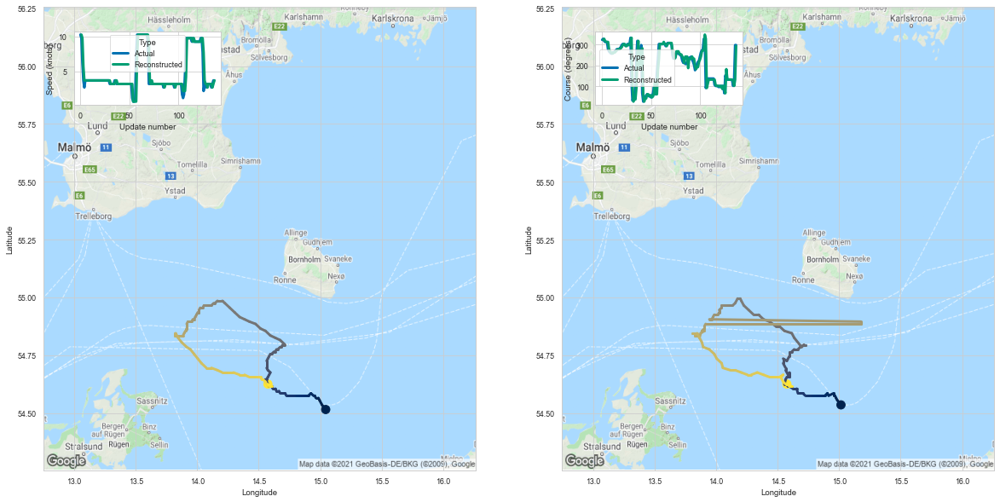

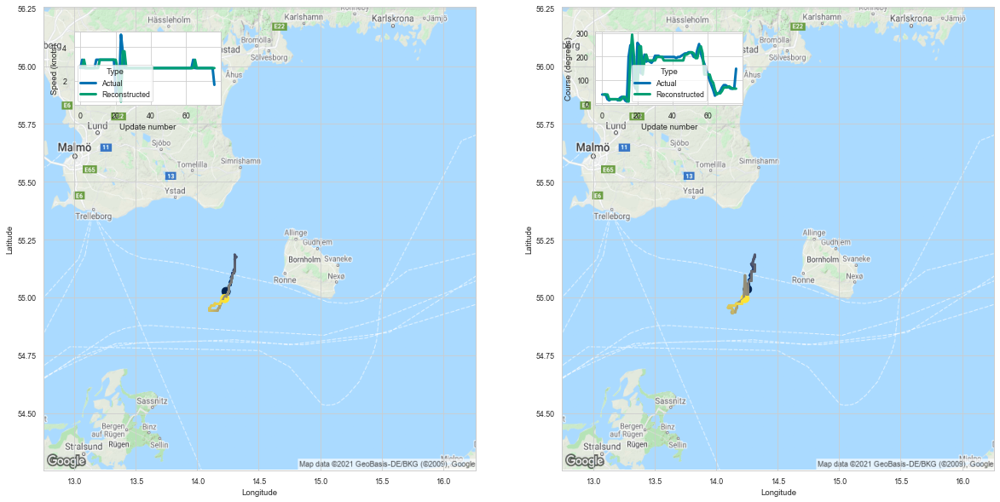

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
73,73,1113112,211542610,Fishing,30,-493.216187,-16.440540
48,48,4303656,261007170,Fishing,101,-1556.727539,-15.413144
5,5,6496,211215500,Fishing,100,-1435.406860,-14.354069
21,21,19488,211243240,Fishing,110,-1563.425049,-14.212955
49,49,1557318,219021428,Fishing,135,-1871.079590,-13.859849
38,38,4942336,265593190,Fishing,58,-734.254639,-12.659563
63,63,7579789,266315000,Fishing,60,-743.614014,-12.393567
91,91,5598936,265750000,Fishing,140,-1732.543945,-12.375314
1,1,4547326,261061000,Fishing,31,-376.830566,-12.155825
7,7,3067071,261002520,Fishing,83,-987.413391,-11.896547


In [12]:
# Focus on the n=25 worst fishing reconstructions
data = summary_models.run_evaluation_get_n(n=25, worst=True, vessel_type=vessel_type)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]
data_set = train_evaluate.validation_dataloader.dataset.datasets[data_set_i]

# Plot the actual and reconstructed trajectories side by side
for idx in range(25): 
    tracks = plot_actual_reconstructed(idx, data_info, data_set)
df_n